In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.preprocessing import LabelEncoder as le


# Data Preprocessing

In [3]:
file_path = 'H:/Dataset/diabetes_dataset.csv'

df = pd.read_csv(file_path)

print("Top 5 rows of the DataFrame:")
print(df.head())

print("\nNumber of missing values in each column:")
print(df.isnull().sum())

print("\nShape of the DataFrame (rows, columns):")
print(df.shape)

print("\nSummary information about the DataFrame:")
print(df.info())

Top 5 rows of the DataFrame:
   gender   age  hypertension  heart_disease smoking_history    bmi  \
0  Female  80.0             0              1           never  25.19   
1  Female  54.0             0              0         No Info  27.32   
2    Male  28.0             0              0           never  27.32   
3  Female  36.0             0              0         current  23.45   
4    Male  76.0             1              1         current  20.14   

   HbA1c_level  blood_glucose_level  diabetes  
0          6.6                  140         0  
1          6.6                   80         0  
2          5.7                  158         0  
3          5.0                  155         0  
4          4.8                  155         0  

Number of missing values in each column:
gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes      

# EDA

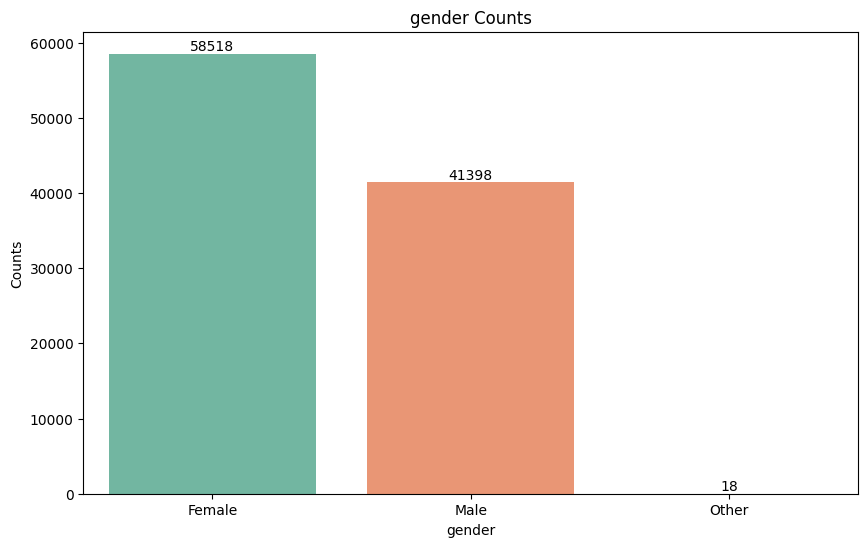

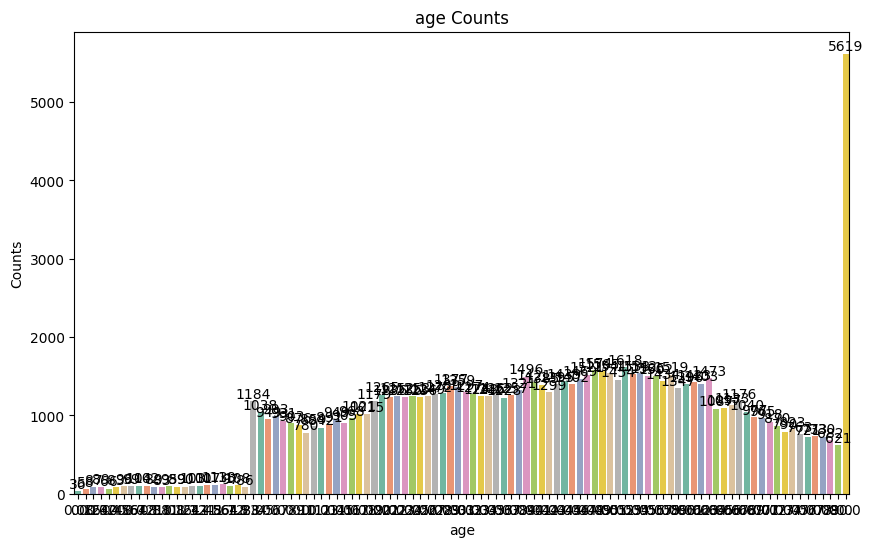

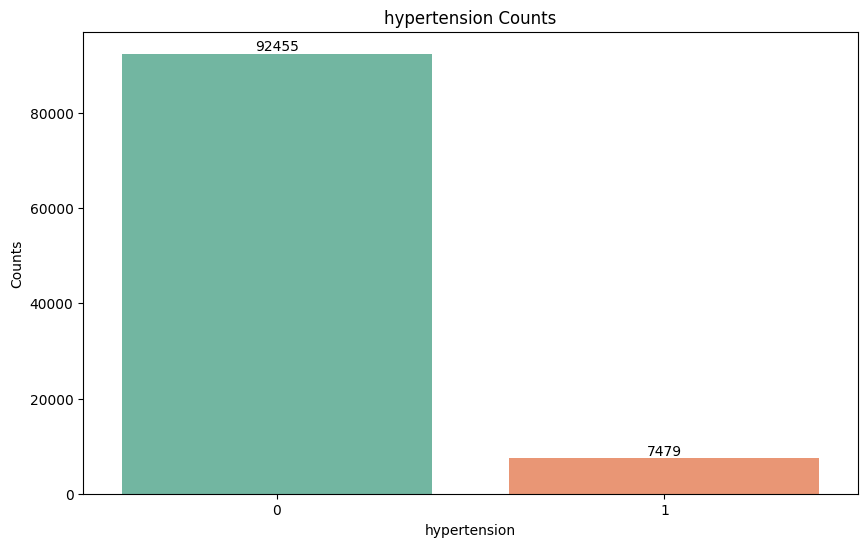

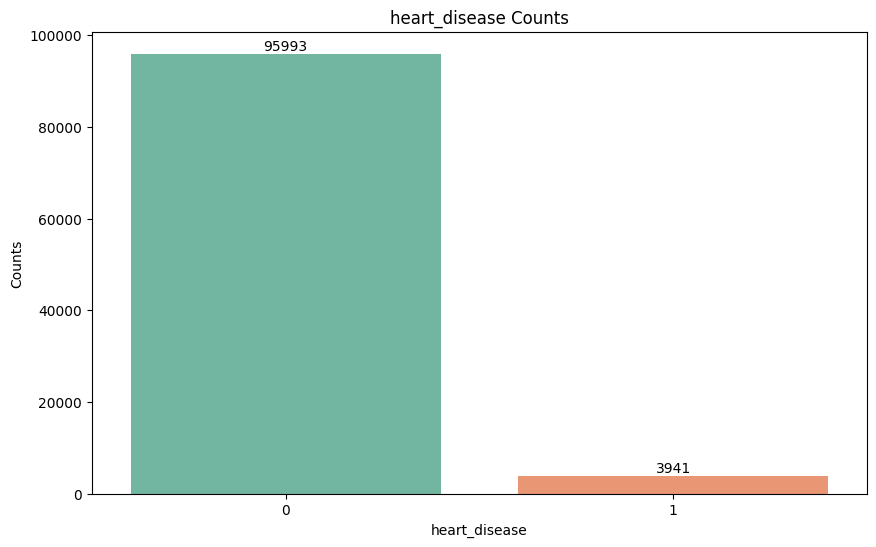

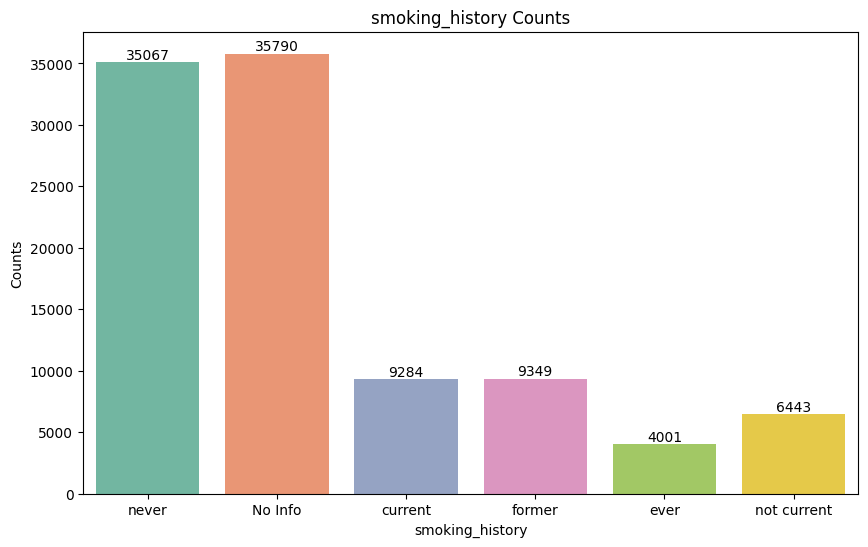

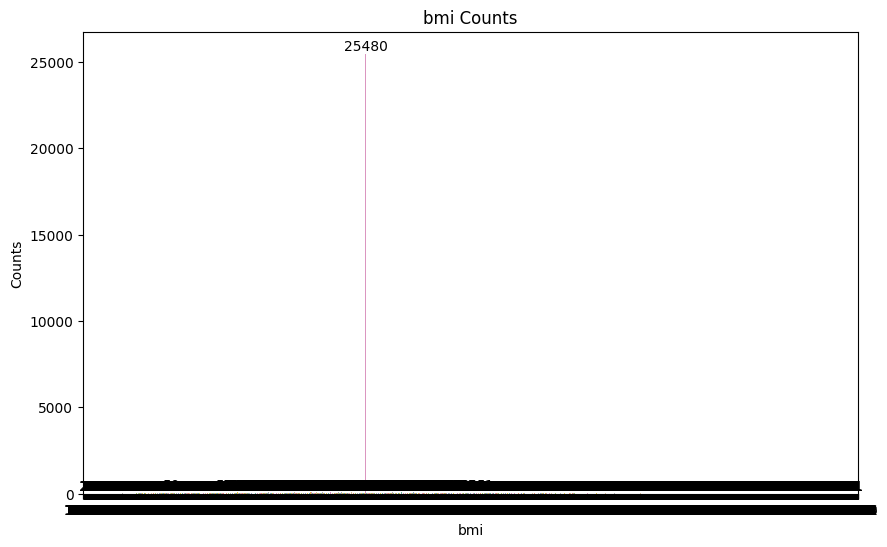

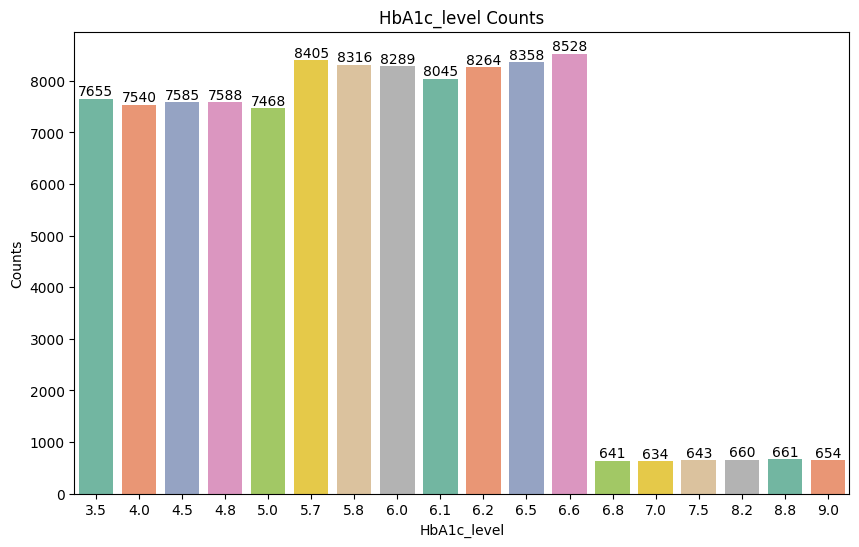

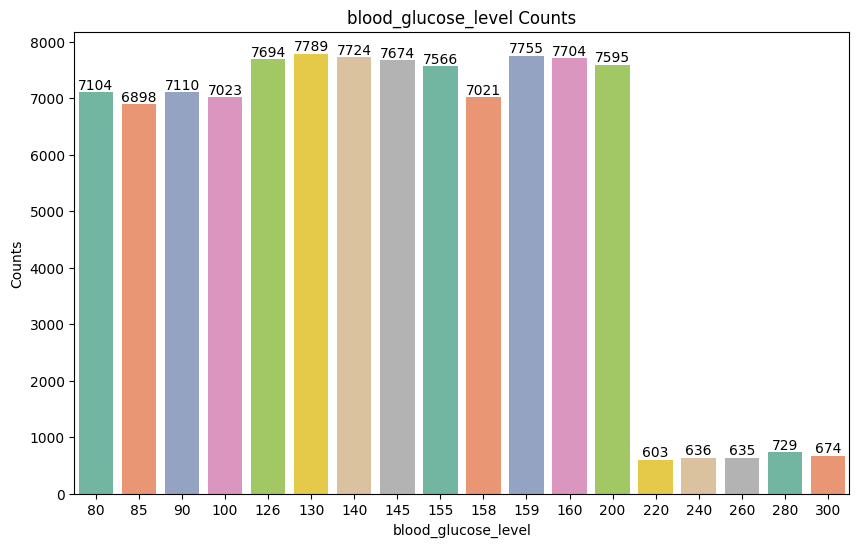

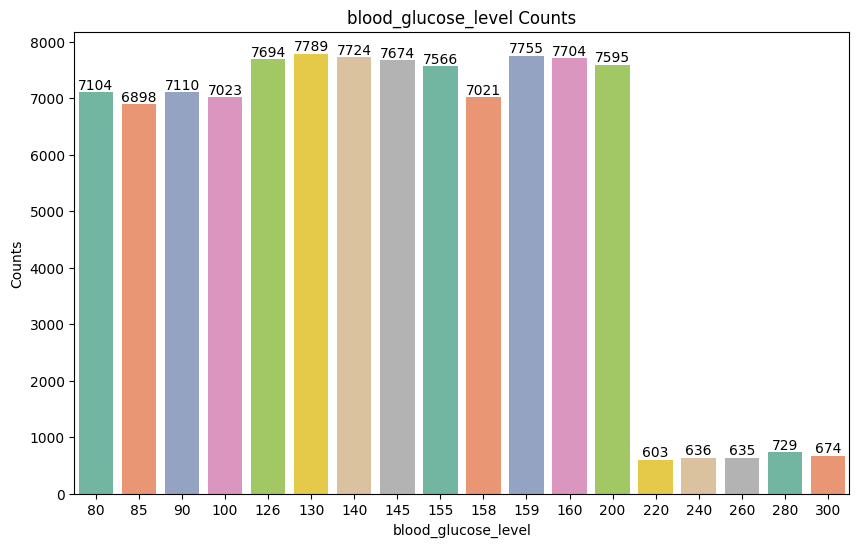

In [4]:
col_names = ['gender', 'age', 'hypertension', 'heart_disease', 'smoking_history', 'bmi', 'HbA1c_level', 'blood_glucose_level','blood_glucose_level']

for col_name in col_names:
   
    plt.figure(figsize=(10, 6))  
    ax=sns.countplot(data=df, x=col_name, palette='Set2')
    
    plt.xlabel(col_name)
    plt.ylabel('Counts')
    plt.title(f'{col_name} Counts')
    
    for bars in ax.containers:
        ax.bar_label(bars)
    plt.show()

#  Which gender has the highest prevalence of diabetes in this data?

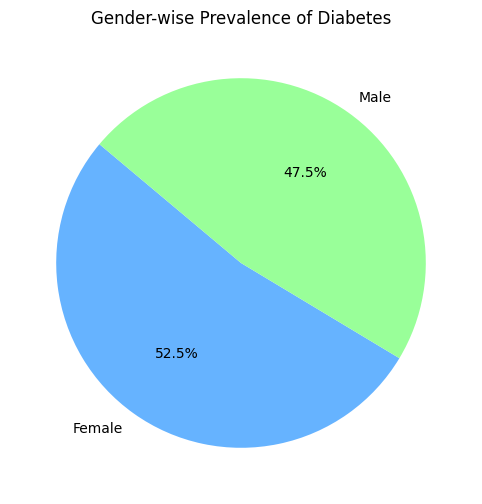

Gender with highest prevalence of diabetes: Female


In [13]:
diabetes_df = df[df['diabetes'] == 1]

# Group by 'gender' and count the occurrences of each gender
gender_diabetes_counts = diabetes_df['gender'].value_counts()

# Create a pie chart
plt.figure(figsize=(8, 6))  # Set the size of the figure
plt.pie(gender_diabetes_counts, labels=gender_diabetes_counts.index, autopct='%1.1f%%', startangle=140, colors=['#66b3ff', '#99ff99'])

# Set the title of the plot
plt.title('Gender-wise Prevalence of Diabetes')

# Show the plot
plt.show()

print("Gender with highest prevalence of diabetes:", gender_diabetes_counts.idxmax())

We can see that the figure above shows that the chances of diabetes in females are 52% and in males are 47%.

# Which gender has a higher chance of developing diabetes, and how does this vary with age?

['Female' 'Male' 'Other']
['0' '1']


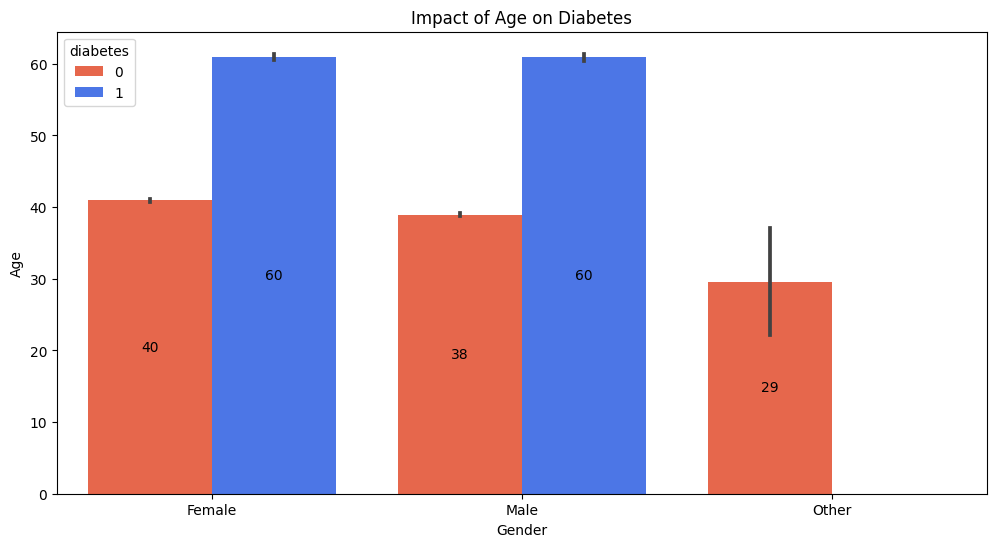

In [6]:
df['gender'] = df['gender'].astype(str)  
df['age'] = df['age'].astype(float)       
df['diabetes'] = df['diabetes'].astype(str)  
print(df['gender'].unique())
print(df['diabetes'].unique())


custom_palette = ['#FF5733', '#336BFF', '#33FF63']

plt.figure(figsize=(12, 6))


ax = sns.barplot(data=df, x='gender', y='age', hue='diabetes', palette=custom_palette)

plt.xlabel('Gender')
plt.xticks(rotation=0)  
plt.ylabel('Age')
plt.title('Impact of Age on Diabetes')


for bars in ax.containers:
    ax.bar_label(bars, fmt='%d', label_type='center', color='black', fontsize=10)


plt.show()

The figure above shows that if any gender crosses the age of 40, especially males and females, the risk of diabetes increases. However, it also depends on other factors as well.

#  Does hypertension increase the risk of developing diabetes?

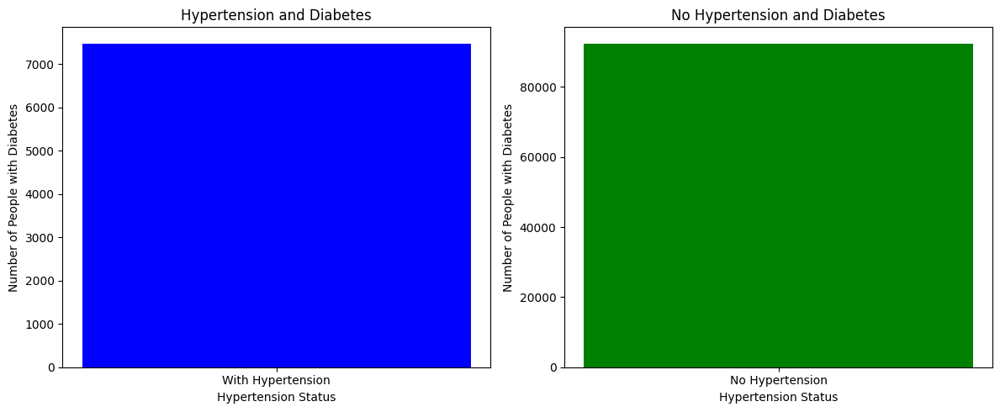

Number of people with hypertension who developed diabetes: 7479
Number of people without hypertension who developed diabetes: 92455


In [5]:

hyper_d = df[df['hypertension'] == 1]

hyper_d = hyper_d.groupby('hypertension')['diabetes'].count().reset_index()

hyper_n = df[df['hypertension'] == 0]

hyper_n = hyper_n.groupby('hypertension')['diabetes'].count().reset_index()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))


axes[0].bar(hyper_d['hypertension'], hyper_d['diabetes'], color='blue')
axes[0].set_title('Hypertension and Diabetes')
axes[0].set_xlabel('Hypertension Status')
axes[0].set_ylabel('Number of People with Diabetes')
axes[0].set_xticks([1])
axes[0].set_xticklabels(['With Hypertension'])


axes[1].bar(hyper_n['hypertension'], hyper_n['diabetes'], color='green')
axes[1].set_title('No Hypertension and Diabetes')
axes[1].set_xlabel('Hypertension Status')
axes[1].set_ylabel('Number of People with Diabetes')
axes[1].set_xticks([0])
axes[1].set_xticklabels(['No Hypertension'])


plt.tight_layout()

plt.show()


print('Number of people with hypertension who developed diabetes:', hyper_d['diabetes'].values[0])
print('Number of people without hypertension who developed diabetes:', hyper_n['diabetes'].values[0])


here is no strong relationship between hypertension and diabetes. The above figure shows that having no hypertension does not necessarily mean that one does not have diabetes. The data indicates that diabetes does not depend on the presence of hypertension. Now let's determine whether there is a relationship between heart diseases and diabetes.

#  Can a heart attack increase a person's risk of developing diabetes?

total heart disease patient 1    3941
Name: heart_disease, dtype: int64


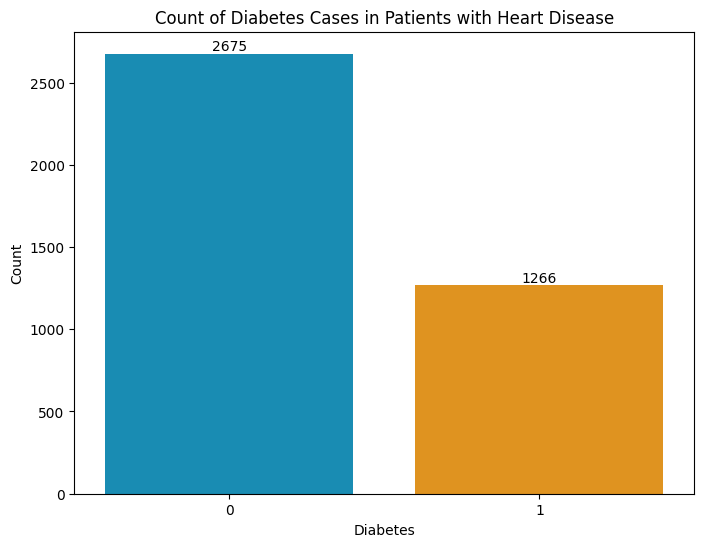

In [6]:
heart_disease_positive = df[df['heart_disease'] == 1]

heart_disease_positive = heart_disease_positive.reset_index()

total_heart_disease=heart_disease_positive['heart_disease'].value_counts()
print(f'total heart disease patient',total_heart_disease)

custom_palette = ["#0099CC", "#FF9900"] 

plt.figure(figsize=(8, 6))

sns.set_palette(custom_palette)

ax=sns.countplot(x='diabetes', data=heart_disease_positive)

plt.xlabel('Diabetes')

plt.ylabel('Count')

plt.title('Count of Diabetes Cases in Patients with Heart Disease')

for bars in ax.containers:
    ax.bar_label(bars)

plt.show()

The figure shows a total of 3941 heart patients, of which 1266 have diabetes and 2675 do not have diabetes.

Similar to hypertension, there is no strong relationship between heart disease and diabetes. Diabetes can occur regardless of whether a person has heart disease or not, as it depends on other factors.

# How does having both hypertension and a heart attack impact the risk of developing diabetes?

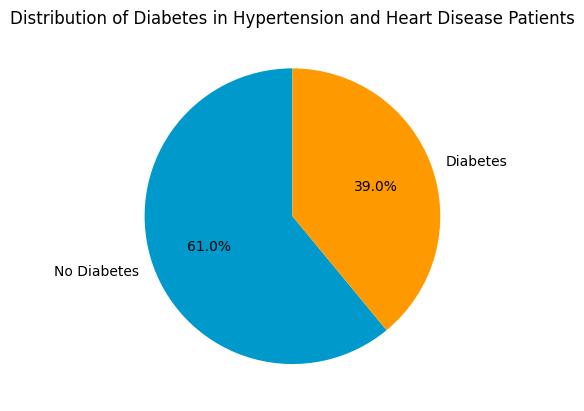

In [12]:
ht_hr = df[(df['hypertension'] == 1) & (df['heart_disease'] == 1)]

ht_hr=ht_hr.reset_index()

diabetes_counts = ht_hr['diabetes'].value_counts(normalize=True) * 100

diabetes_counts.plot.pie(autopct='%1.1f%%', labels=['No Diabetes', 'Diabetes'], startangle=90)

plt.title('Distribution of Diabetes in Hypertension and Heart Disease Patients')

plt.ylabel('')  

plt.show()

The pie chart shows that if a person has both hypertension and heart disease, they have a 39% chance of also having diabetes. If they do not have diabetes, they have a 61% chance.

Let's analyze the diabetes genderwise in people with both hypertension and heart disease

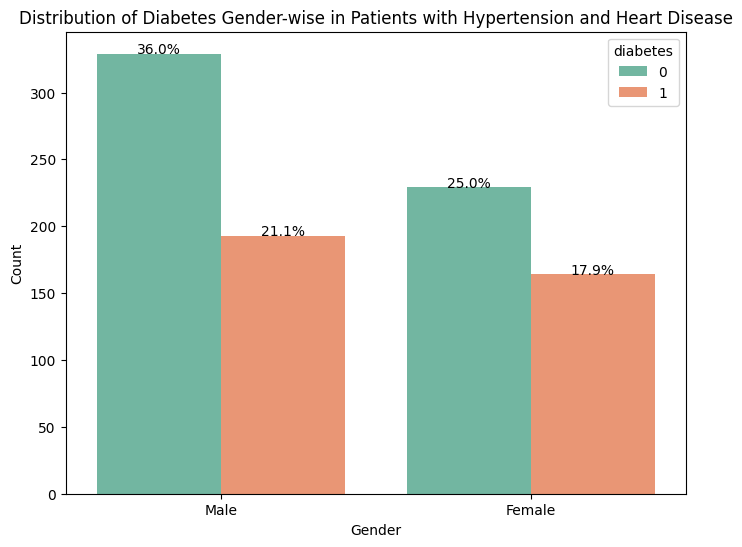

In [13]:
ht_hr_df=df[(df['hypertension'] == 1) & (df['heart_disease'] == 1)]

plt.figure(figsize=(8, 6))

sns.countplot(data=ht_hr_df, x='gender', hue='diabetes', palette='Set2')

plt.title('Distribution of Diabetes Gender-wise in Patients with Hypertension and Heart Disease')

plt.xlabel('Gender')

plt.ylabel('Count')


total_counts = len(ht_hr_df)
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{height/total_counts*100:.1f}%', (p.get_x() + p.get_width() / 2., height),
                       ha='center', va='baseline')

plt.show()

The above figure shows that 21% of males and 17.9% of females who have both hypertension and heart disease also have diabetes.

# Is there a link between smoking and diabetes?

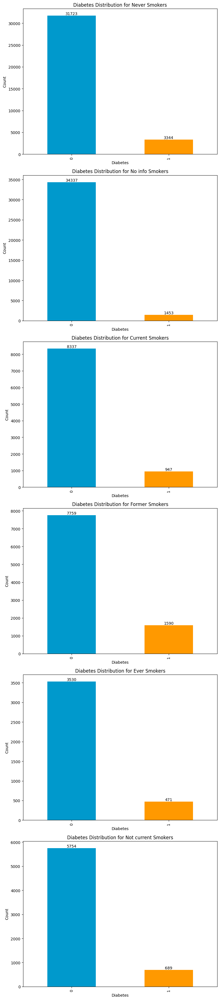

In [14]:

smoking_categories = ['never','No Info','current','former','ever','not current']

fig, axes = plt.subplots(nrows=len(smoking_categories), figsize=(8, 6 * len(smoking_categories)))

colors = ["#0099CC", "#FF9900"]

for i, smoking_category in enumerate(smoking_categories):
    
    subset_df = df[df['smoking_history'] == smoking_category]
    
    ax = subset_df['diabetes'].value_counts().plot(kind='bar', color=colors, ax=axes[i])
    
    ax.set_title(f'Diabetes Distribution for {smoking_category.capitalize()} Smokers')
    ax.set_xlabel('Diabetes')
    ax.set_ylabel('Count')
    
    
    for p in ax.patches:
        ax.annotate(str(p.get_height()), (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', xytext=(0, 5), textcoords='offset points')

plt.tight_layout()


plt.show()


* People who never smoke have diabetes counts of 3344, and 31723 people who never smoke do not have diabetes.

* People with diabetes count 1453, and 34337 people without diabetes do not have information about whether or not they have diabetes.

* People who currently smoke have diabetes counts of 947, and 8337 people who currently smoke do not have diabetes.

* People who have ever smoked have diabetes counts of 471, and 3530 people who have ever smoked do not have diabetes.

* People who never smoke have diabetes counts of 689, and 5754 people who never smoke do not have diabetes.


# How much does hemoglobin impact diabetes?

In [15]:
min_hba1c = df['HbA1c_level'].min()
max_hba1c = df['HbA1c_level'].max()
mean_hba1c = df['HbA1c_level'].mean()

print(f"Minimum HbA1c Level: {min_hba1c}")
print(f"Maximum HbA1c Level: {max_hba1c}")
print(f"Mean HbA1c Level: {mean_hba1c}")

scatter_fig = px.scatter(df, x='HbA1c_level', y='diabetes', title='HbA1c Level vs. Diabetes')
scatter_fig.show()

box_fig = px.box(df, x='diabetes', y='HbA1c_level', title='HbA1c Level vs. Diabetes')
box_fig.show()

Minimum HbA1c Level: 3.5
Maximum HbA1c Level: 9.0
Mean HbA1c Level: 5.527447115095963


There is a significant relationship between hemoglobin and diabetes. The above figure indicates that a hemoglobin level ranging from 4.8 to 6.2 is considered healthy. However, if a person has an HbA1c level higher than 6.1, it could be considered risky. There are many people with a hemoglobin level lower than 6.8 who have diabetes, potentially due to their high glucose levels. However, diabetes risk also depends on other factors. There is a high chance of diabetes risk. To verify this relationship, let's create a box plot. Additionally, let's create another dataframe that specifically includes individuals with an HbA1c level greater than or equal to 6.8, enabling us to analyze the associated diabetes risk.

In [16]:
hb_level = df[df['HbA1c_level'] >= 6.8]

fig = px.box(hb_level, x='diabetes', y='HbA1c_level',
             title='Impact of Hemoglobin Level 6.8 on Diabetes')

fig.show()

The above figure indicates that if the hemoglobin level is greater than 6.8, there is a high likelihood of diabetes risk based on the data. now let's check the the relation between blood glucose level with diabetes.

# What is the relationship between blood glucose levels and diabetes?

In [17]:
min_glucose_level = df['blood_glucose_level'].min()
max_glucose_level = df['blood_glucose_level'].max()
mean_glucose_level = df['blood_glucose_level'].mean()

scatter_fig = px.scatter(df, x='diabetes', y='blood_glucose_level',
                         title='Blood Glucose Level vs. Diabetes')

box_fig = px.box(df, x='diabetes', y='blood_glucose_level',
                 title='Blood Glucose Level vs. Diabetes')

scatter_fig.show()

box_fig.show()

print('minimum level of blood Glucose', min_glucose_level)
print('maximum level of blood Glucose', max_glucose_level)
print('Average level of blood Glucose', mean_glucose_level)

minimum level of blood Glucose 80
maximum level of blood Glucose 300
Average level of blood Glucose 138.0551864230392


We can observe a significant relationship between blood glucose levels and diabetes. The figure shows that the range between 100 and 160 in blood glucose levels is mostly considered healthy. However, the range between 160 and above is considered risky, and when the glucose level exceeds 200, the chances of diabetes risk are very high. Now, let's create another dataframe that consists of values where the glucose level is greater than or equal to 200 and identify the number of individuals with diabetes.

In [18]:
gl_level=df[df['blood_glucose_level']>=200]

fig=px.box(gl_level,x='diabetes',y='blood_glucose_level',
          title='Glucose Level 200 or 200+ impact on diabetes')

fig.show()

The above figure indicates that, based on the data, there are many people with a blood glucose level of 200 who do not have diabetes, likely due to their hemoglobin level being less than 6.8. Diabetes risk depends on other factors as well. Diabetic patients are most commonly found within the blood glucose level range of 220 to 280.

# Is there any relationship between BMI and diabetes?

In [19]:

def calculate_bmi_statistics(dataframe):
    """
    Calculate basic BMI statistics from a DataFrame.

    Args:
        dataframe (pd.DataFrame): The DataFrame containing BMI data.

    Returns:
        dict: A dictionary containing minimum, maximum, and mean BMI values.
    """
    min_bmi = dataframe['bmi'].min()
    max_bmi = dataframe['bmi'].max()
    mean_bmi = dataframe['bmi'].mean()
    
    bmi_statistics = {
        "Minimum BMI": min_bmi,
        "Maximum BMI": max_bmi,
        "Mean BMI": mean_bmi
    }
    
    return bmi_statistics

def create_bmi_vs_diabetes_scatter_plot(dataframe):
    """
    Create a scatter plot of BMI vs. Diabetes status using Plotly Express.

    Args:
        dataframe (pd.DataFrame): The DataFrame containing BMI and diabetes data.

    Returns:
        None
    """
    fig = px.box(dataframe, x='diabetes', y='bmi', title='BMI vs. Diabetes')
    fig.show()


bmi_stats = calculate_bmi_statistics(df)

# Display BMI statistics
for stat_name, stat_value in bmi_stats.items():
    print(f"{stat_name}: {stat_value}")

# Create and display the scatter plot
create_bmi_vs_diabetes_scatter_plot(df)


Minimum BMI: 10.01
Maximum BMI: 95.69
Mean BMI: 27.321991514399503


We can observe that there is no strong relationship between BMI and diabetes. If a person has a low BMI score, the risk of diabetes increases; similarly, when a person has a high BMI, the chances of diabetes risk also increase, potentially affecting both conditions.

Model Selection

We used three models, namely the decision tree classifier, random forest classifier, and logistic regression classifier, for a classification problem.

In [6]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import r2_score,mean_absolute_error
from sklearn.metrics import accuracy_score
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression

In [7]:
x=df.drop('diabetes',axis=1)
y=df['diabetes']

In [4]:
x

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level
0,Female,80.0,0,1,never,25.19,6.6,140
1,Female,54.0,0,0,No Info,27.32,6.6,80
2,Male,28.0,0,0,never,27.32,5.7,158
3,Female,36.0,0,0,current,23.45,5.0,155
4,Male,76.0,1,1,current,20.14,4.8,155
...,...,...,...,...,...,...,...,...
99929,Female,80.0,0,0,No Info,27.32,6.2,90
99930,Female,2.0,0,0,No Info,17.37,6.5,100
99931,Male,66.0,0,0,former,27.83,5.7,155
99932,Female,24.0,0,0,never,35.42,4.0,100


Training The model

In [8]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=10)

RandomForestClassifier

In [9]:
step1 = ColumnTransformer(transformers=[
    ('col_tnf',OneHotEncoder(sparse=False),[0,4])
],remainder='passthrough')

step2 = RandomForestClassifier()

pipe = Pipeline([
    ('step1',step1),
    ('step2',step2)
])

pipe.fit(x_train,y_train)

y_pred = pipe.predict(x_test)

print('R2 score',r2_score(y_test,y_pred))
print('MAE',mean_absolute_error(y_test,y_pred))
score = accuracy_score(y_test, y_pred)
print("Model Score:", score)

c:\Users\harsh\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:828: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


R2 score 0.5951219211453875
MAE 0.031070195627157654
Model Score: 0.9689298043728424


LogisticRegression

In [13]:
step1 = ColumnTransformer(transformers=[
    ('col_tnf',OneHotEncoder(sparse=False),[0,4])
],remainder='passthrough')

step2 = LogisticRegression()

pipe = Pipeline([
    ('step1',step1),
    ('step2',step2)
])

pipe.fit(x_train,y_train)

y_pred = pipe.predict(x_test)

print('R2 score',r2_score(y_test,y_pred))
print('MAE',mean_absolute_error(y_test,y_pred))
score = accuracy_score(y_test, y_pred)
print("Model Score:", score)

c:\Users\harsh\anaconda3\lib\site-packages\sklearn\preprocessing\_encoders.py:828: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


R2 score 0.4471230098732507
MAE 0.042427577925651674
Model Score: 0.9575724220743483


c:\Users\harsh\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


DecisionTreeClassifier

In [12]:



column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(), ['gender', 'smoking_history']),
    ('scaler', StandardScaler(), ['age','hypertension','heart_disease','bmi','HbA1c_level','blood_glucose_level'])
])


pipeline = Pipeline([
    ('preprocessing', column_transformer),
    ('model', DecisionTreeClassifier())
])


pipeline.fit(x_train, y_train)


y_pred = pipeline.predict(x_test)

score = accuracy_score(y_test, y_pred)
print("Model Score:", score)



Model Score: 0.9532195927352779


We can see that the Random Forest Classifier performs better than the other models, with a better score than the Logistic Regression Classifier and the Decision Tree Classifier.

conclusion:

In [ ]:
#pickle.dump(df,open('diabetes_df00.pkl','wb'))
#pickle.dump(pipeline,open('modpipeline.pkl','wb'))

In [ ]:
#from sklearn.tree import DecisionTreeClassifier
#from sklearn.preprocessing import StandardScaler
#from sklearn.impute import SimpleImputer

# Perform data preprocessing
#imputer = SimpleImputer(strategy='mean')
#x_train_imputed = imputer.fit_transform(x_train)
#x_test_imputed = imputer.transform(x_test)

#scaler = StandardScaler()
#x_train_scaled = scaler.fit_transform(x_train_imputed)
#x_test_scaled = scaler.transform(x_test_imputed)

# Create an instance of the DecisionTreeClassifier
#clf = DecisionTreeClassifier()

# Fit the classifier to the training data
#clf.fit(x_train_scaled, y_train)

# Make predictions on the test data
#y_pred = clf.predict(x_test_scaled)

#score = accuracy_score(y_test, y_pred)
print("Model Score:", score)

In [ ]:
#score = accuracy_score(y_test, y_pred)

print("Model Score:", score)
